In [1]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
import datetime


In [2]:
global_temps = pd.read_csv('./Climate_data/temp_data/GlobalTemperatures.csv')

#major_city = pd.read_csv('./Climate_data/temp_data/GlobalLandTemperaturesByMajorCity.csv')

#city = pd.read_csv('./Climate_data/temp_data/GlobalLandTemperaturesByCity.csv')


## 1. Check the  Global Temperatures data. Top/Bottom 5, shape, info, null values

In [3]:
global_temps.head()

,dt,LandAverageTemperature,LandAverageTemperatureUncertainty,LandMaxTemperature,LandMaxTemperatureUncertainty,LandMinTemperature,LandMinTemperatureUncertainty,LandAndOceanAverageTemperature,LandAndOceanAverageTemperatureUncertainty
0,1750-01-01,3.034,3.574,NaN,NaN,NaN,NaN,NaN,NaN
1,1750-02-01,3.083,3.702,NaN,NaN,NaN,NaN,NaN,NaN
2,1750-03-01,5.626,3.076,NaN,NaN,NaN,NaN,NaN,NaN
3,1750-04-01,8.490,2.451,NaN,NaN,NaN,NaN,NaN,NaN
4,1750-05-01,11.573,2.072,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
global_temps.tail()

,dt,LandAverageTemperature,LandAverageTemperatureUncertainty,LandMaxTemperature,LandMaxTemperatureUncertainty,LandMinTemperature,LandMinTemperatureUncertainty,LandAndOceanAverageTemperature,LandAndOceanAverageTemperatureUncertainty
3187,2015-08-01,14.755,0.072,20.699,0.110,9.005,0.170,17.589,0.057
3188,2015-09-01,12.999,0.079,18.845,0.088,7.199,0.229,17.049,0.058
3189,2015-10-01,10.801,0.102,16.450,0.059,5.232,0.115,16.290,0.062
3190,2015-11-01,7.433,0.119,12.892,0.093,2.157,0.106,15.252,0.063
3191,2015-12-01,5.518,0.100,10.725,0.154,0.287,0.099,14.774,0.062


In [5]:
global_temps.shape

(3192, 9)

In [6]:
global_temps.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3192 entries, 0 to 3191
Data columns (total 9 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   dt                                         3192 non-null   object 
 1   LandAverageTemperature                     3180 non-null   float64
 2   LandAverageTemperatureUncertainty          3180 non-null   float64
 3   LandMaxTemperature                         1992 non-null   float64
 4   LandMaxTemperatureUncertainty              1992 non-null   float64
 5   LandMinTemperature                         1992 non-null   float64
 6   LandMinTemperatureUncertainty              1992 non-null   float64
 7   LandAndOceanAverageTemperature             1992 non-null   float64
 8   LandAndOceanAverageTemperatureUncertainty  1992 non-null   float64
dtypes: float64(8), object(1)
memory usage: 224.6+ KB


In [7]:
global_temps.isnull().sum()

dt                                              0
LandAverageTemperature                         12
LandAverageTemperatureUncertainty              12
LandMaxTemperature                           1200
LandMaxTemperatureUncertainty                1200
LandMinTemperature                           1200
LandMinTemperatureUncertainty                1200
LandAndOceanAverageTemperature               1200
LandAndOceanAverageTemperatureUncertainty    1200
dtype: int64

In [8]:
global_temps.describe()

,LandAverageTemperature,LandAverageTemperatureUncertainty,LandMaxTemperature,LandMaxTemperatureUncertainty,LandMinTemperature,LandMinTemperatureUncertainty,LandAndOceanAverageTemperature,LandAndOceanAverageTemperatureUncertainty
count,3180.000000,3180.000000,1992.000000,1992.000000,1992.000000,1992.000000,1992.000000,1992.000000
mean,8.374731,0.938468,14.350601,0.479782,2.743595,0.431849,15.212566,0.128532
std,4.381310,1.096440,4.309579,0.583203,4.155835,0.445838,1.274093,0.073587
min,-2.080000,0.034000,5.900000,0.044000,-5.407000,0.045000,12.475000,0.042000
25%,4.312000,0.186750,10.212000,0.142000,-1.334500,0.155000,14.047000,0.063000
50%,8.610500,0.392000,14.760000,0.252000,2.949500,0.279000,15.251000,0.122000
75%,12.548250,1.419250,18.451500,0.539000,6.778750,0.458250,16.396250,0.151000
max,19.021000,7.880000,21.320000,4.373000,9.715000,3.498000,17.611000,0.457000


Unfortunately this data is not so helpful as it is global and data collection points and accuracy cannot be trusted in the early years. I will explore the Country and major cities datasets next.

## 2. Check the Country Temperatures. Top/Bottom 5, shape, info, null values

In [9]:
country = pd.read_csv('./Climate_data/temp_data/GlobalLandTemperaturesByCountry.csv')

In [10]:
country.head()

,dt,AverageTemperature,AverageTemperatureUncertainty,Country
0,1743-11-01,4.384,2.294,Åland
1,1743-12-01,NaN,NaN,Åland
2,1744-01-01,NaN,NaN,Åland
3,1744-02-01,NaN,NaN,Åland
4,1744-03-01,NaN,NaN,Åland


In [11]:
country.tail()

,dt,AverageTemperature,AverageTemperatureUncertainty,Country
577457,2013-05-01,19.059,1.022,Zimbabwe
577458,2013-06-01,17.613,0.473,Zimbabwe
577459,2013-07-01,17.000,0.453,Zimbabwe
577460,2013-08-01,19.759,0.717,Zimbabwe
577461,2013-09-01,NaN,NaN,Zimbabwe


In [12]:
country.shape

(577462, 4)

In [13]:
country.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 577462 entries, 0 to 577461
Data columns (total 4 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   dt                             577462 non-null  object 
 1   AverageTemperature             544811 non-null  float64
 2   AverageTemperatureUncertainty  545550 non-null  float64
 3   Country                        577462 non-null  object 
dtypes: float64(2), object(2)
memory usage: 17.6+ MB


In [14]:
country.isnull().sum()

dt                                   0
AverageTemperature               32651
AverageTemperatureUncertainty    31912
Country                              0
dtype: int64

## 3. Data by State

In [15]:
state_temps = pd.read_csv('./Climate_data/temp_data/GlobalLandTemperaturesByState.csv')

In [16]:
state_temps.head()

,dt,AverageTemperature,AverageTemperatureUncertainty,State,Country
0,1855-05-01,25.544,1.171,Acre,Brazil
1,1855-06-01,24.228,1.103,Acre,Brazil
2,1855-07-01,24.371,1.044,Acre,Brazil
3,1855-08-01,25.427,1.073,Acre,Brazil
4,1855-09-01,25.675,1.014,Acre,Brazil


In [17]:
state_temps.shape

(645675, 5)

In [18]:
state_temps['dt'] = pd.to_datetime(state_temps['dt'], format='%Y-%m-%d')

## 4. Remove data pre 1900

In [32]:
state_temps_1900 = state_temps[state_temps['dt'] >= '1900-01-01']

In [20]:
state_temps_1900.set_index('dt', inplace=True)

In [21]:
state_temps_1900.head()

,AverageTemperature,AverageTemperatureUncertainty,State,Country
dt,,,,
1900-01-01,25.732,1.080,Acre,Brazil
1900-02-01,26.050,1.080,Acre,Brazil
1900-03-01,26.574,0.894,Acre,Brazil
1900-04-01,25.947,1.192,Acre,Brazil
1900-05-01,25.557,0.856,Acre,Brazil


## 5. Check the shape and null values

In [22]:
state_temps_1900.shape

(328965, 4)

In [23]:
state_temps_1900.isnull().sum()

AverageTemperature               181
AverageTemperatureUncertainty    181
State                              0
Country                            0
dtype: int64

## 6. Fill the null values with the rolling mean of the previous 2-3 days.

In [24]:
rolling_mean = state_temps_1900['AverageTemperature'].rolling(window=3, min_periods=2).mean()

In [25]:
state_temps_1900.loc[state_temps_1900['AverageTemperature'].isnull(), 'AverageTemperature'] = rolling_mean[state_temps_1900['AverageTemperature'].isnull()]

In [26]:
rolling_mean_avt = state_temps_1900['AverageTemperatureUncertainty'].rolling(window=3, min_periods=2).mean()

In [27]:
state_temps_1900.loc[state_temps_1900['AverageTemperatureUncertainty'].isnull(), 'AverageTemperatureUncertainty'] = rolling_mean_avt[state_temps_1900['AverageTemperatureUncertainty'].isnull()]

In [28]:
state_temps_1900.isnull().sum()

AverageTemperature               0
AverageTemperatureUncertainty    0
State                            0
Country                          0
dtype: int64

## 7. Lets group the data and have a look at the results

/tmp/ipykernel_14121/2831952486.py:11: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  monthly_avg = group.resample('M', on='dt').mean()
/tmp/ipykernel_14121/2831952486.py:11: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  monthly_avg = group.resample('M', on='dt').mean()
/tmp/ipykernel_14121/2831952486.py:11: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  monthly_avg = group.resample('M', on='dt').mean()
/tmp/ipykernel_1

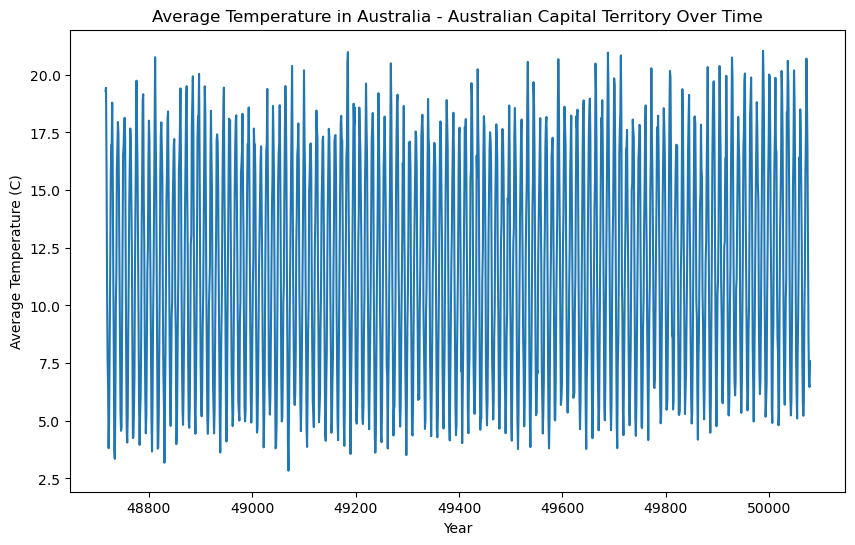

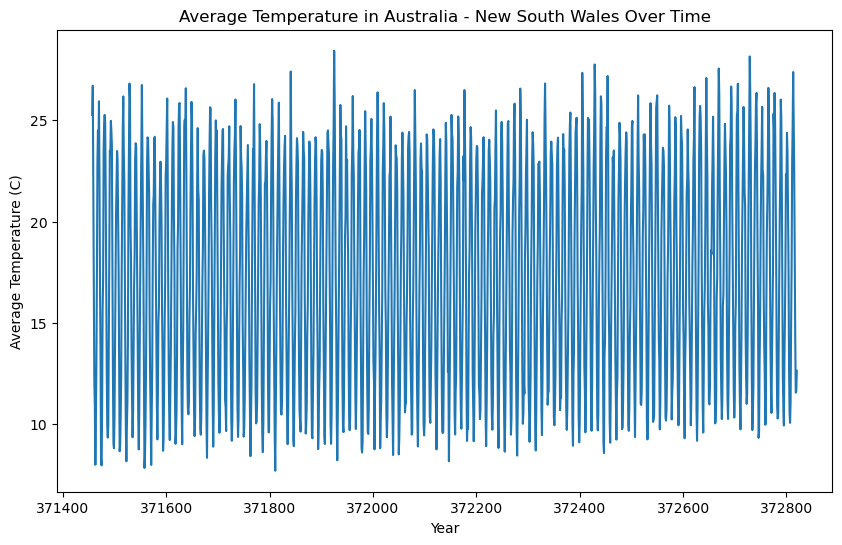

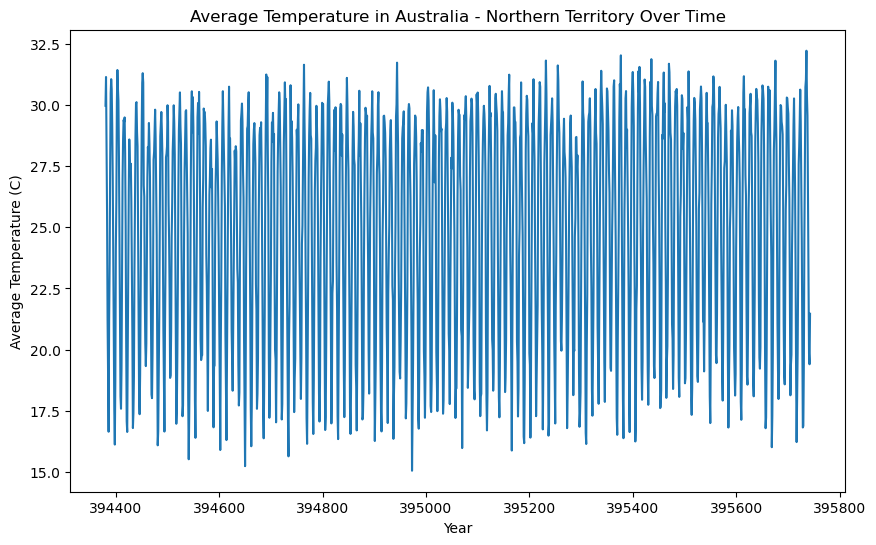

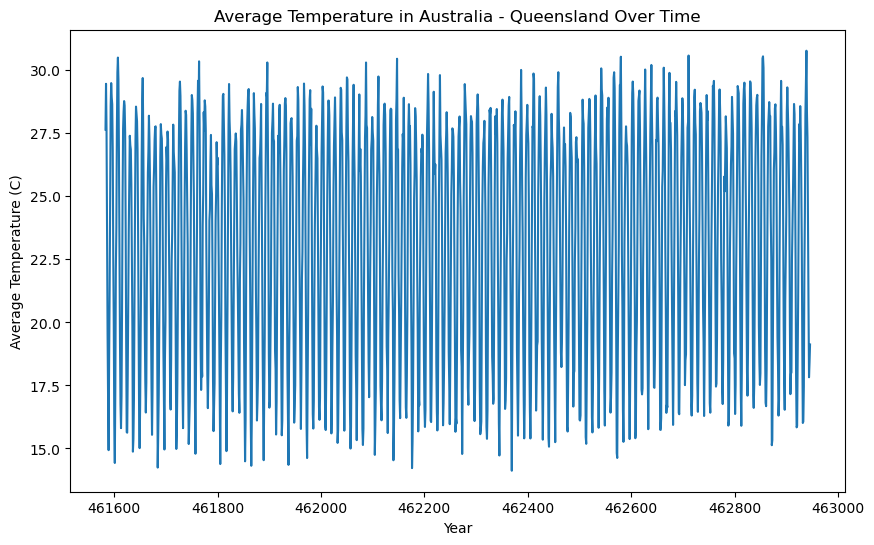

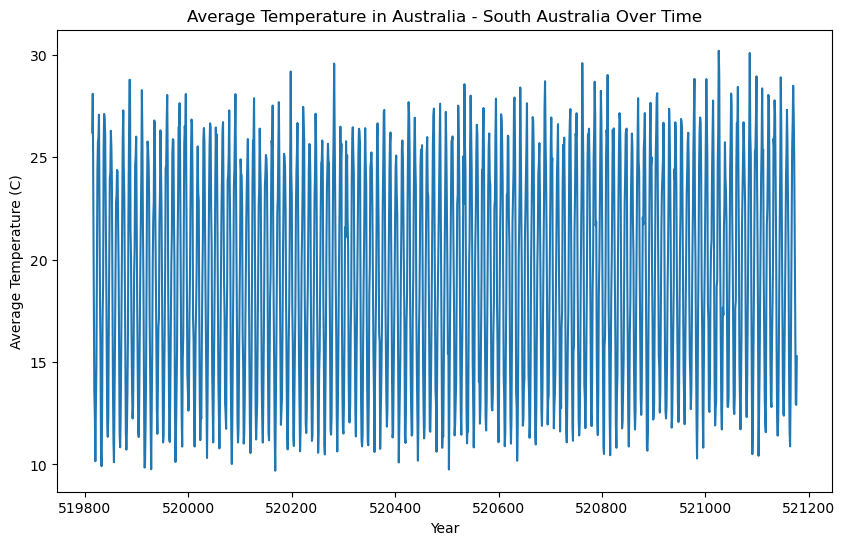

...

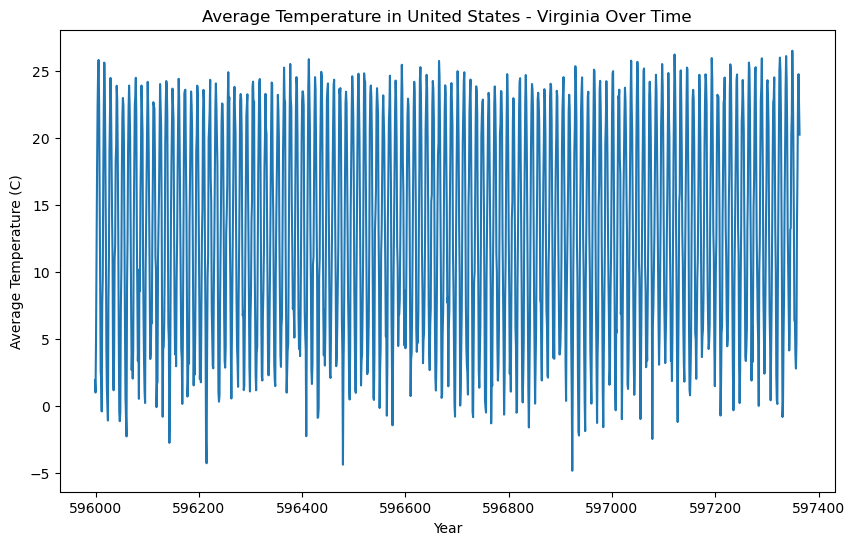

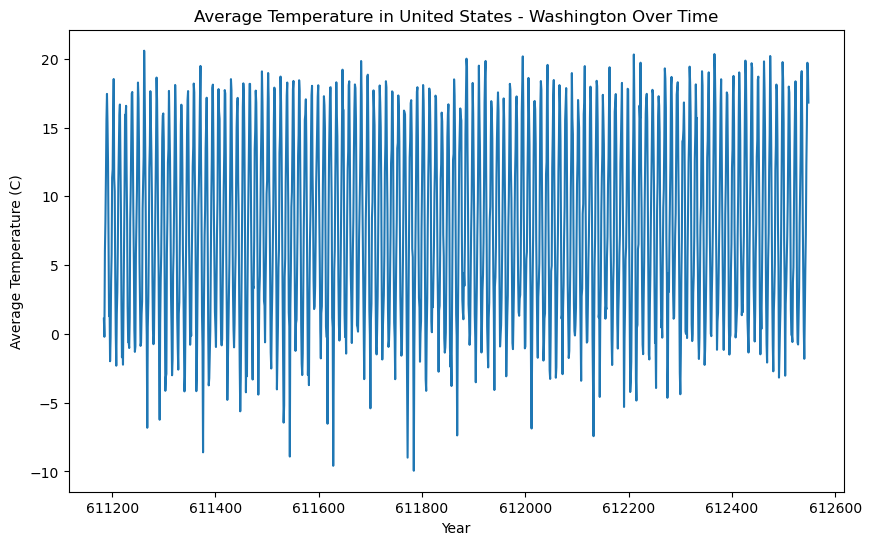

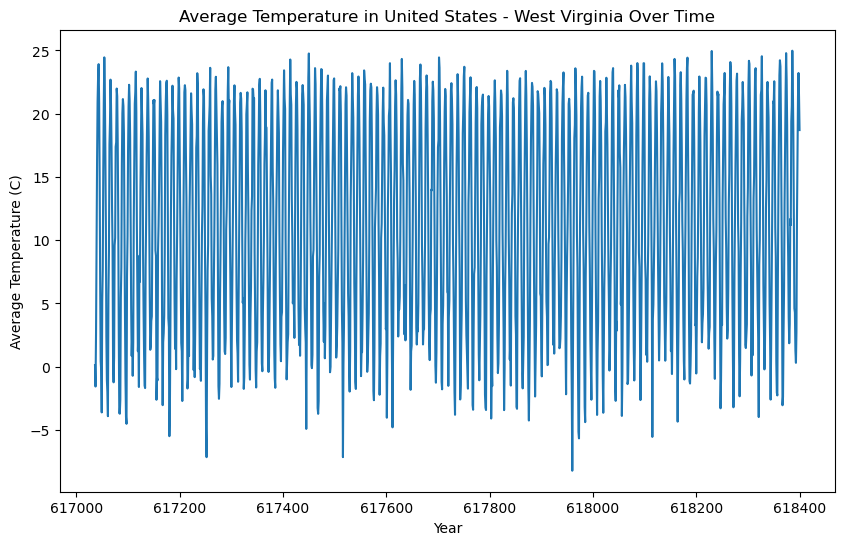

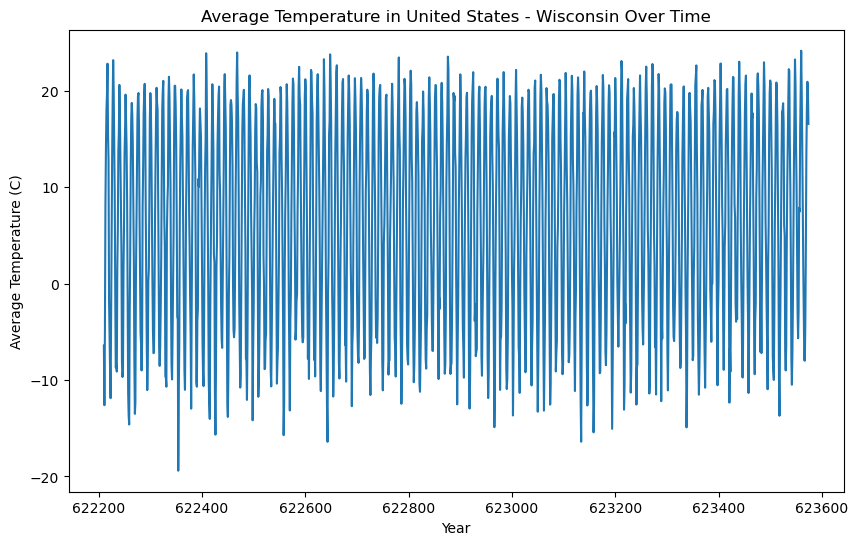

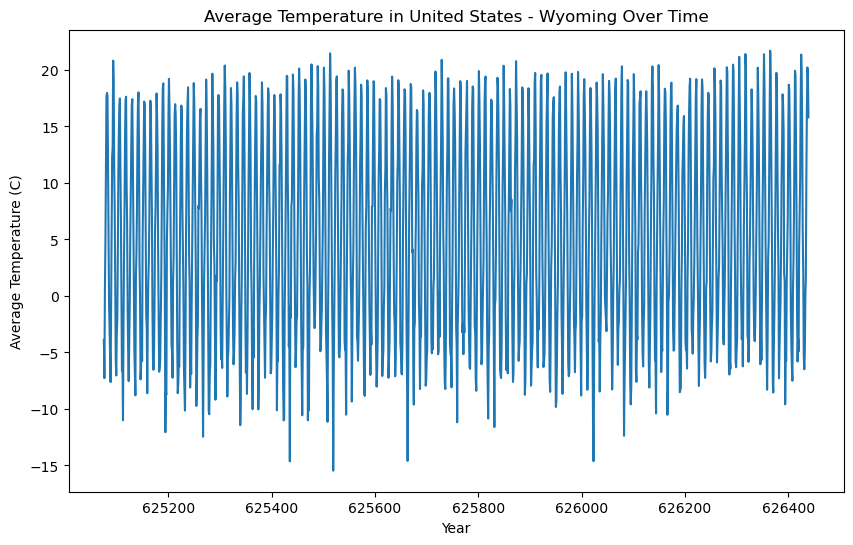

In [37]:
# group the data by the 'Country' and 'State' columns
grouped = state_temps_1900.groupby(['Country', 'State'])

# resample the data to months



# create a line chart for each group
for name, group in grouped:

    monthly_avg = group.resample('M', on='dt').mean()
    fig, ax = plt.subplots(figsize=(10, 6))
    group['AverageTemperature'].plot(ax=ax)
    ax.set_xlabel('Year')
    ax.set_ylabel('Average Temperature (C)')
    ax.set_title(f'Average Temperature in {name[0]} - {name[1]} Over Time')

# show the chart
#plt.show()

## Import precipitation data

In [31]:
from netCDF4 import Dataset as dt

ModuleNotFoundError: No module named 'netCDF4'

In [ ]:
filestr = './Climate_data/precipitation_data/full_data_monthly_v2022_2011_2020_05.nc'

In [ ]:
ncfile = dt(filestr, 'r')

In [ ]:
print(ncfile.variables)

In [ ]:
lon = np.array(ncfile.variables['lon'][:],dtype=np.float64)
lat = np.array(ncfile.variables['lat'][:],dtype=np.float64)
time = np.array(ncfile.variables['time'][:],dtype=np.float64)
precip = np.array(ncfile.variables['precip'][:],dtype=np.float32)
numgauge = np.array(ncfile.variables['numgauge'][:],dtype=np.float32)
infilled_numgauges = np.array(ncfile.variables['infilled_numgauges'][:],dtype=np.float32)
interpolation_error = np.array(ncfile.variables['interpolation_error'][:],dtype=np.float32)
interpolation_error_infilled = np.array(ncfile.variables['interpolation_error_infilled'][:],dtype=np.float32)
diff_new_old_method = np.array(ncfile.variables['diff_new_old_method'][:],dtype=np.float32)

In [ ]:
print(precip)

In [ ]:
my_array = np.array(lon,lat,time)

In [ ]:
prepicitation = pd.DataFrame(lon,lat, columns = [['lon','lat' ]])


In [ ]:
prepicitation 